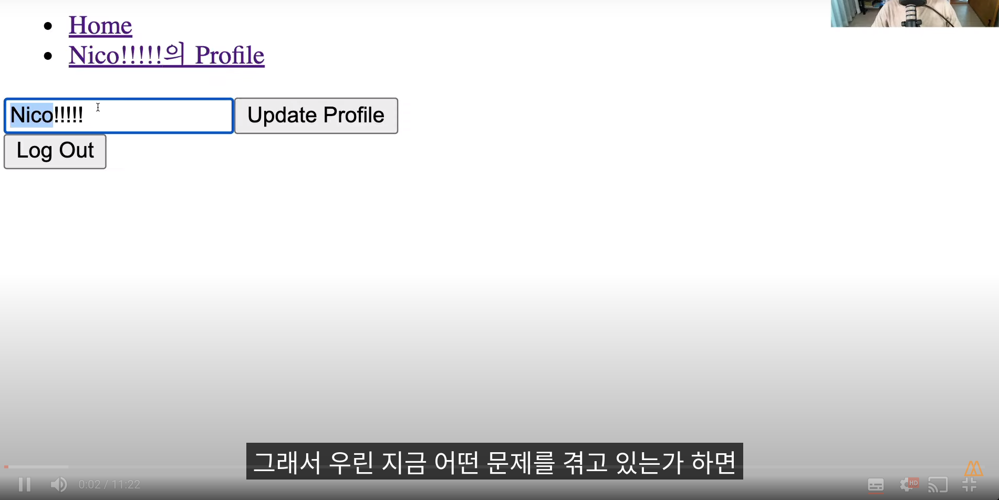

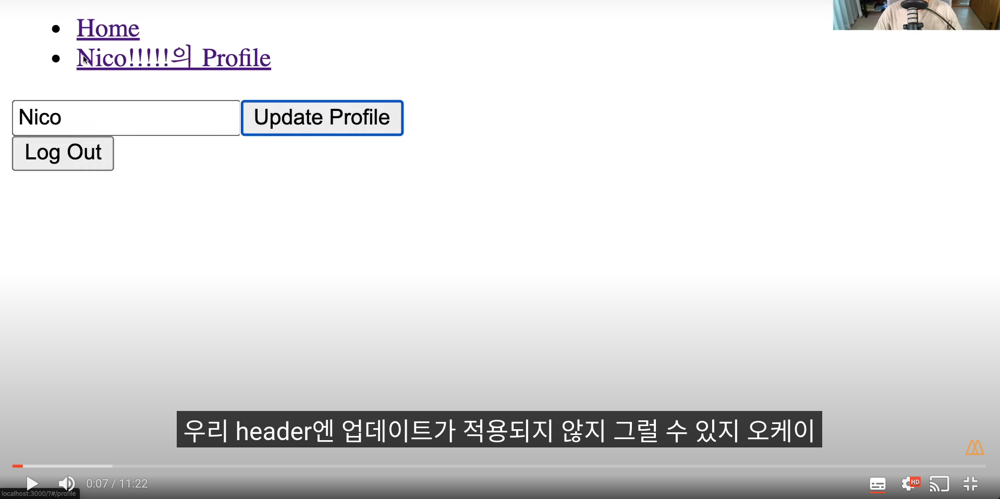

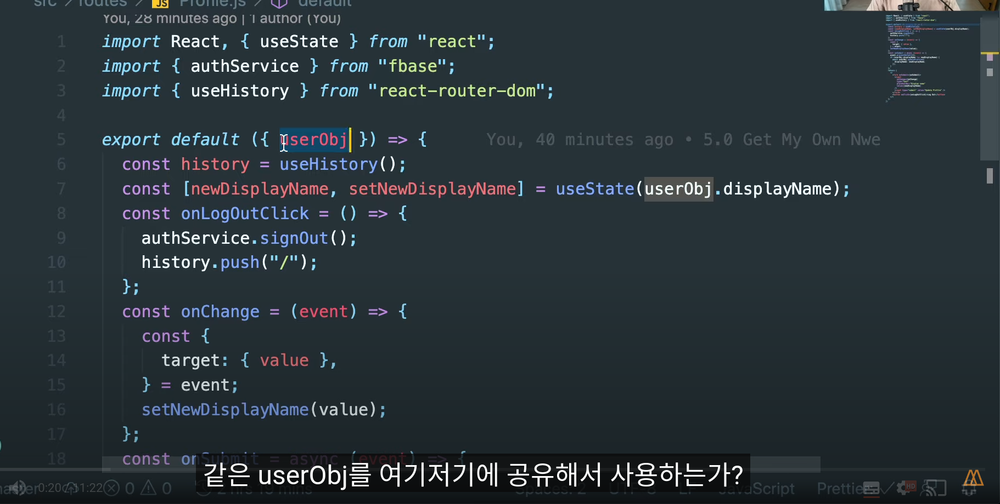

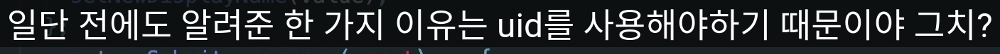

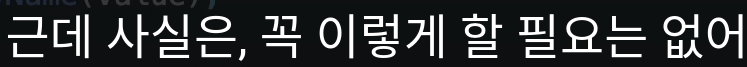

...

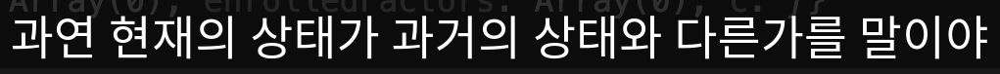

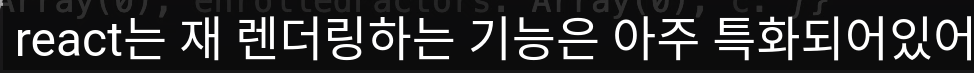

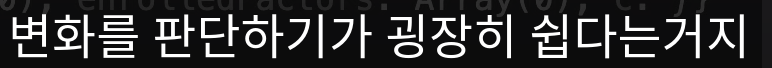

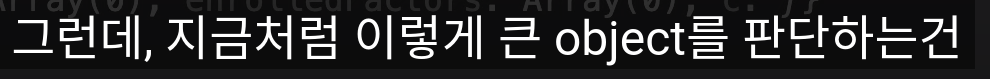

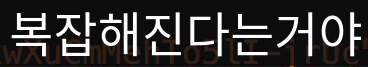

# 2가지 옵션

## 1. object의 크기 줄이는 방법
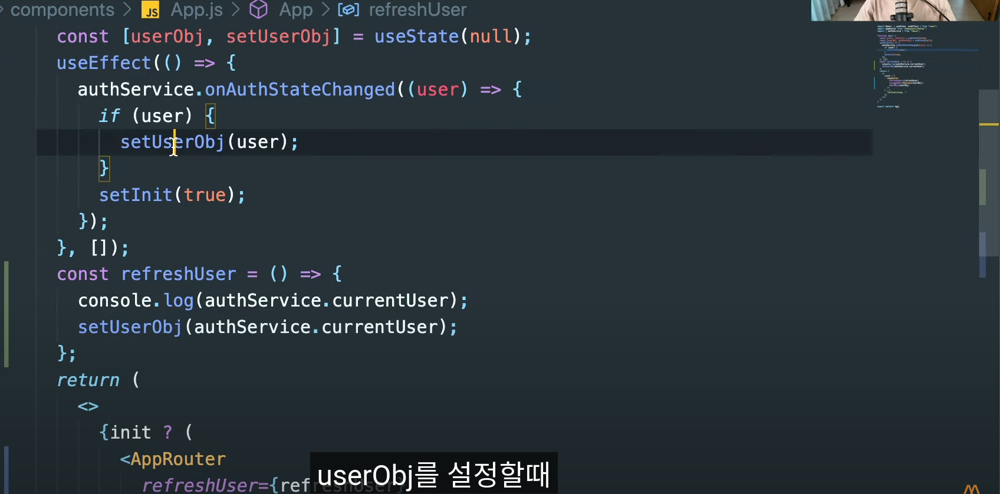
## 

# Profile.js
```Profile.js
import { authService, dbService } from "fbase";

import { useNavigate } from "react-router-dom";
import { useEffect, useState } from "react";
import { collection, getDocs, orderBy, query, where } from "firebase/firestore";

import { updateProfile } from "@firebase/auth";

function Profile({ refreshUser, userObj }) {
  const navigate = useNavigate();
  const [newDisplayName, setNewDisplayName] = useState(userObj.displayName);

  const onLogOutClick = () => {
    authService.signOut();
    // 버그 발생 위치 : 로그아웃을 하여도 로그인상태로 유지되는 현상 발생
    // 해결방법 : App에 State로 관리 가능
    navigate("/");
  };

  const getMyJweets = async () => {
    const q = query(
      collection(dbService, "jweets"),
      where("creatorId", "==", `${userObj.uid}`),
      orderBy("createdAt", "desc")
    );

    const querySnapshot = await getDocs(q);
    querySnapshot.forEach((doc) => {
      console.log(doc.id, " => ", doc.data());
    });
  };

  useEffect(() => {
    getMyJweets();
  }, []);

  const onSubmit = async (event) => {
    event.preventDefault();
    if (userObj.displayName !== newDisplayName) {
      await updateProfile(authService.currentUser, {
        displayName: newDisplayName,
      });
      refreshUser();
    }
  };

  const onChange = (event) => {
    const {
      target: { value },
    } = event;

    setNewDisplayName(value);
  };

  return (
    <>
      <form onSubmit={onSubmit}>
        <input
          type="text"
          placeholder="Display name"
          value={newDisplayName}
          onChange={onChange}
        />
        <input type="submit" value="Update Profile" />
      </form>
      <button onClick={onLogOutClick}>Log Out</button>
    </>
  );
}

export default Profile;

```

# App.js
```js
import { useEffect, useState } from "react";
import AppRouter from "components/Router";
import { authService } from "fbase";
// firebase/auth https://firebase.google.com/docs/reference/js/auth.auth.md#authonauthstatechanged
import { onAuthStateChanged, updateProfile } from "firebase/auth";

function App() {
  const [init, setInit] = useState(false);
  const [isLoggedIn, setIsLoggedIn] = useState(false);
  // 로그인시 유저 정보를 가지고 있을 변수
  const [userObj, setUserObj] = useState(null);
  useEffect(() => {
    onAuthStateChanged(authService, (user) => {
      if (user) {
        setIsLoggedIn(true);
        setUserObj({
          displayName: user.displayName,
          uid: user.uid,
          updateProfile: (args) =>
            updateProfile(user, { displayName: user.displayName }),
        });
      } else {
        setIsLoggedIn(false);
      }
      setInit(true);
    });
  }, []);

  const refreshUser = () => {
    const user = authService.currentUser;
    setUserObj({
      displayName: user.displayName,
      uid: user.uid,
      updateProfile: (args) =>
        updateProfile(user, { displayName: user.displayName }),
    });
  };

  return (
    <>
      {init ? (
        <AppRouter
          refreshUser={refreshUser}
          isLoggedIn={isLoggedIn}
          userObj={userObj}
        />
      ) : (
        "Initializing"
      )}
      {/* <footer>&copy; {new Date().getFullYear()} Jwitter</footer> */}
    </>
  );
}

export default App;

```